# OCR

In [1]:
#from PIL import Image
import cv2
import numpy as np
import matplotlib.pyplot as plt
#import pytesseract

In [2]:
image_path = 'input/1.png'
img = cv2.imread(image_path)
img_original = img.copy()

In [3]:
#https://stackoverflow.com/questions/28816046/
#displaying-different-images-with-actual-size-in-matplotlib-subplot
def display(im_path):
    dpi = 80
    im_data = plt.imread(im_path)

    height, width = im_data.shape[:2]
    
    # What size does the figure need to be in inches to fit the image?
    figsize = width / float(dpi), height / float(dpi)

    # Create a figure of the right size with one axes that takes up the full figure
    fig = plt.figure(figsize=figsize)
    ax = fig.add_axes([0, 0, 1, 1])

    # Hide spines, ticks, etc.
    ax.axis('off')

    # Display the image.
    ax.imshow(im_data, cmap='gray')

    plt.show()

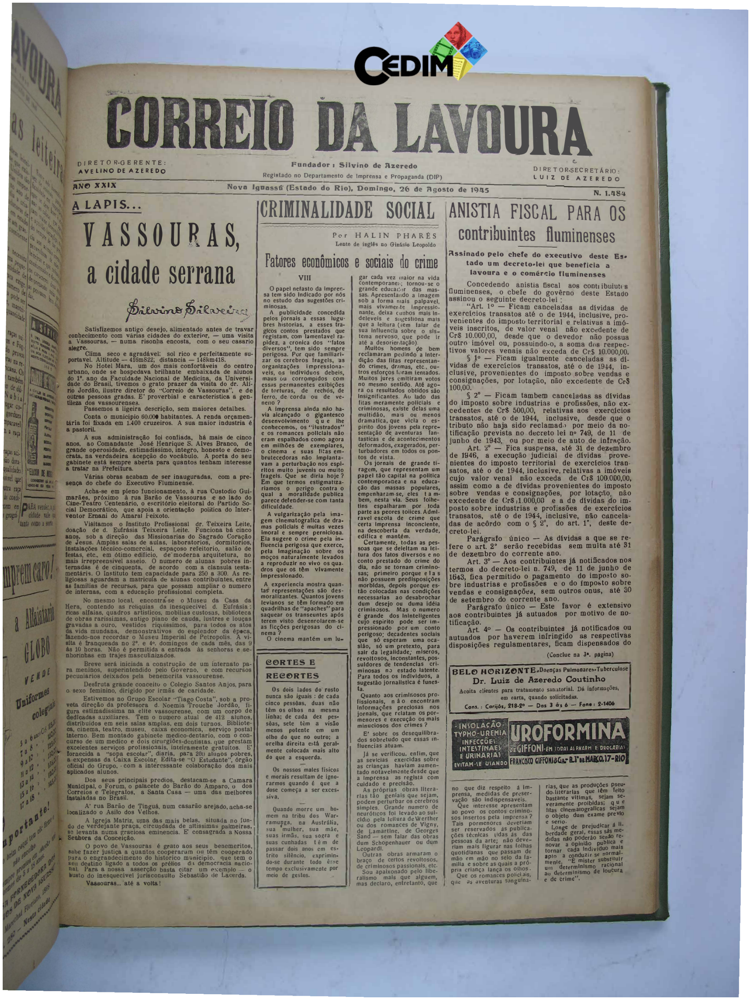

In [4]:
display(image_path)

## Binarizando a imagem

In [5]:
def grayscale(image):
    return cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

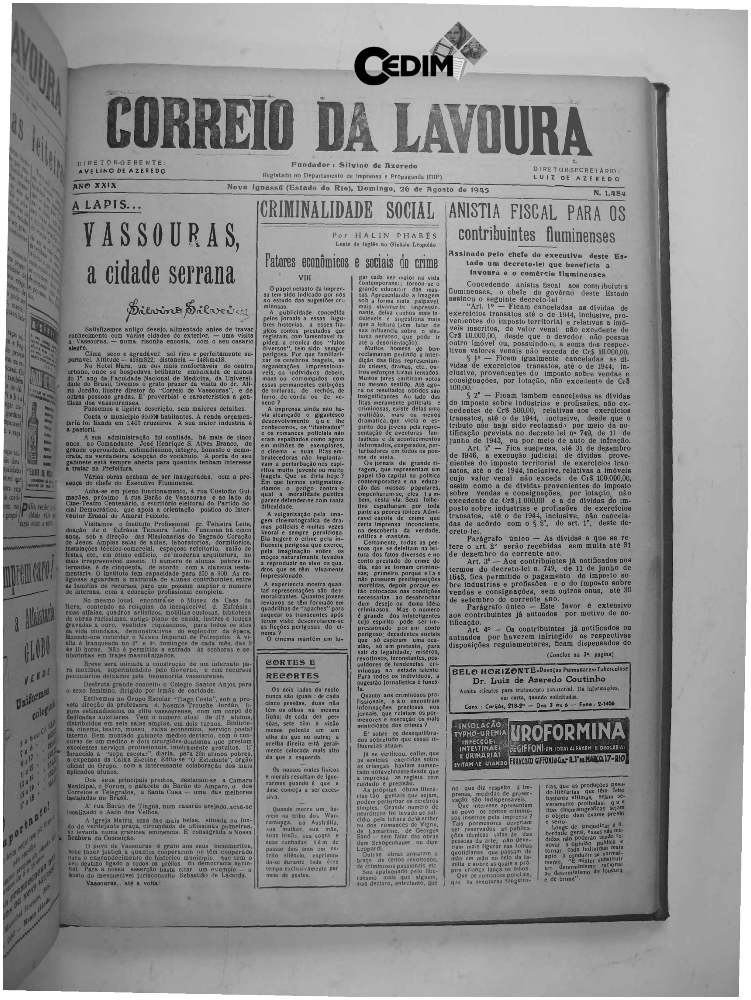

In [6]:
img_gray = grayscale(img)
cv2.imwrite('temp/gray.png', img_gray)
display('temp/gray.png')

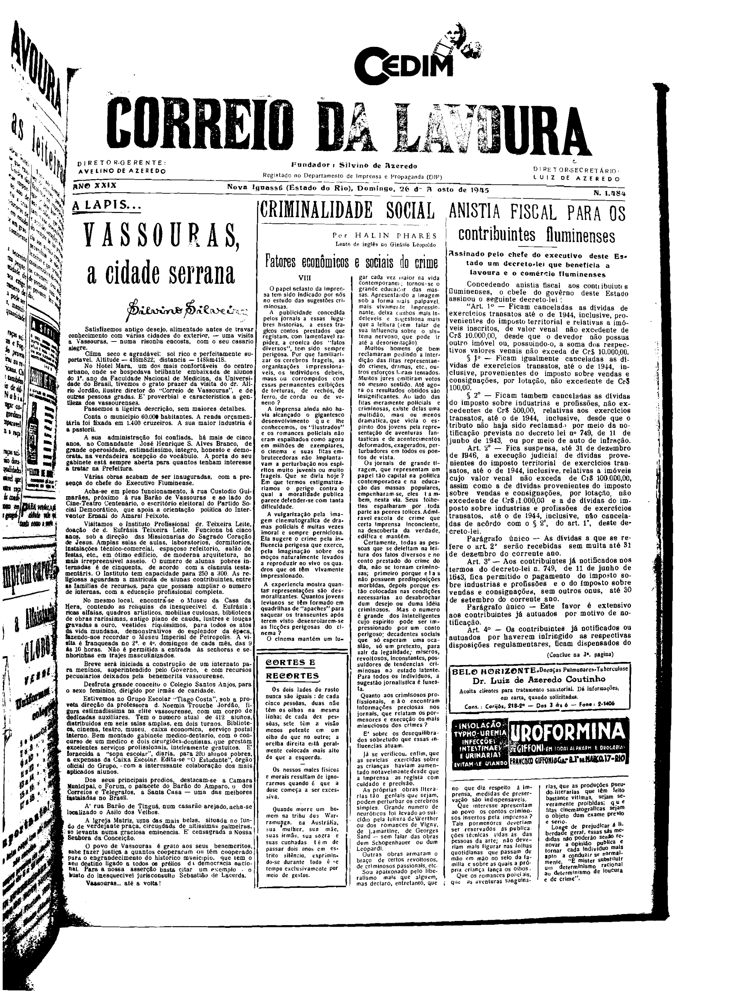

In [7]:
thresh, img_bw = cv2.threshold(img_gray, 100, 255, cv2.THRESH_BINARY)
cv2.imwrite('temp/bw.png', img_bw)
display('temp/bw.png')

## Remoção de Noise

In [8]:
def remove_noise(image):
    kernel = np.ones((1,1), np.uint8)
    image = cv2.dilate(image, kernel, iterations=1)
    #kernel = np.ones((1,1), np.uint8)
    image = cv2.erode(image, kernel, iterations=1)
    image = cv2.morphologyEx(image, cv2.MORPH_CLOSE, kernel)
    image = cv2.medianBlur(image, 3)
    return image

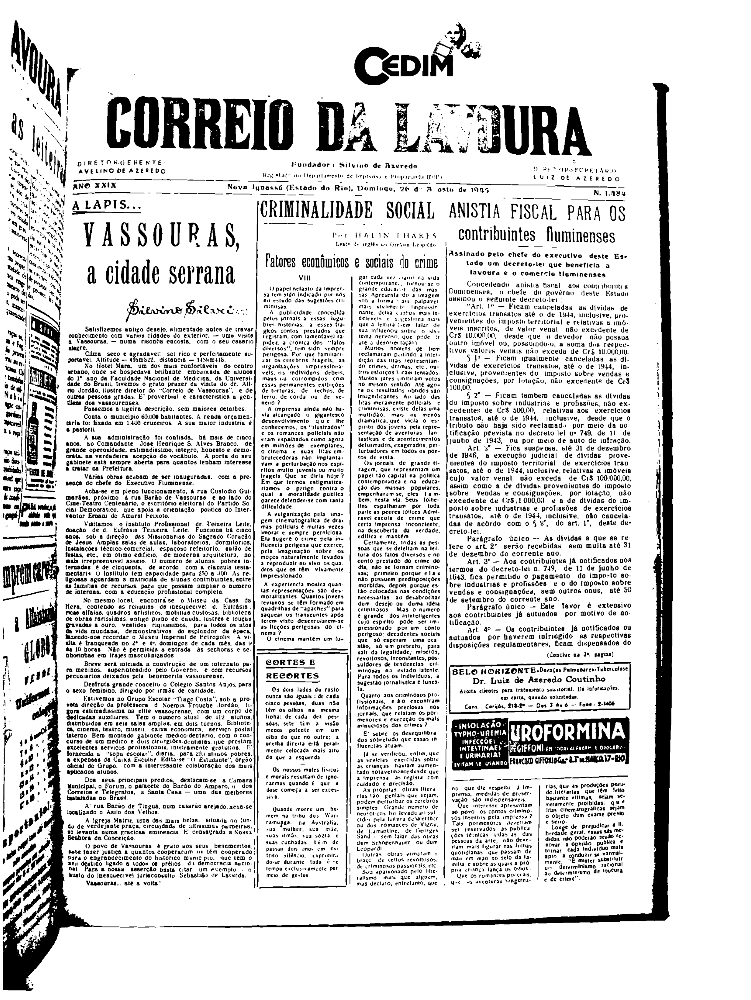

In [9]:
img_no_noise = remove_noise(img_bw)
cv2.imwrite('temp/no_noise.png', img_no_noise)
display('temp/no_noise.png')

## OCR com PyTesseract

In [10]:
from PIL import Image
import pytesseract

In [173]:
import re
def remove_extra_spaces(text):
    splitted = [line.strip() for line in text.splitlines() if len(line.strip()) > 0]
    text = '\n'.join(splitted)
    text = re.sub(' +', ' ', text)
    return text

def treat_hyphenation(text):
    text = re.sub('-\n', '', text)
    return text

In [172]:
def run_ocr(image_path, output_path):
    img = Image.open(image_path)
    result = pytesseract.image_to_string(img, lang='por')
    result = remove_extra_spaces(result)
    result = treat_hyphenation(result)
    with open(output_path, 'w', encoding='utf-8') as f:
        f.write(result)

In [174]:
%time run_ocr('input/1.png', 'output/plain.txt')
%time run_ocr('temp/bw.png', 'output/bw.txt')

Wall time: 15.8 s
Wall time: 12.9 s


## Pegar o conteúdo principal

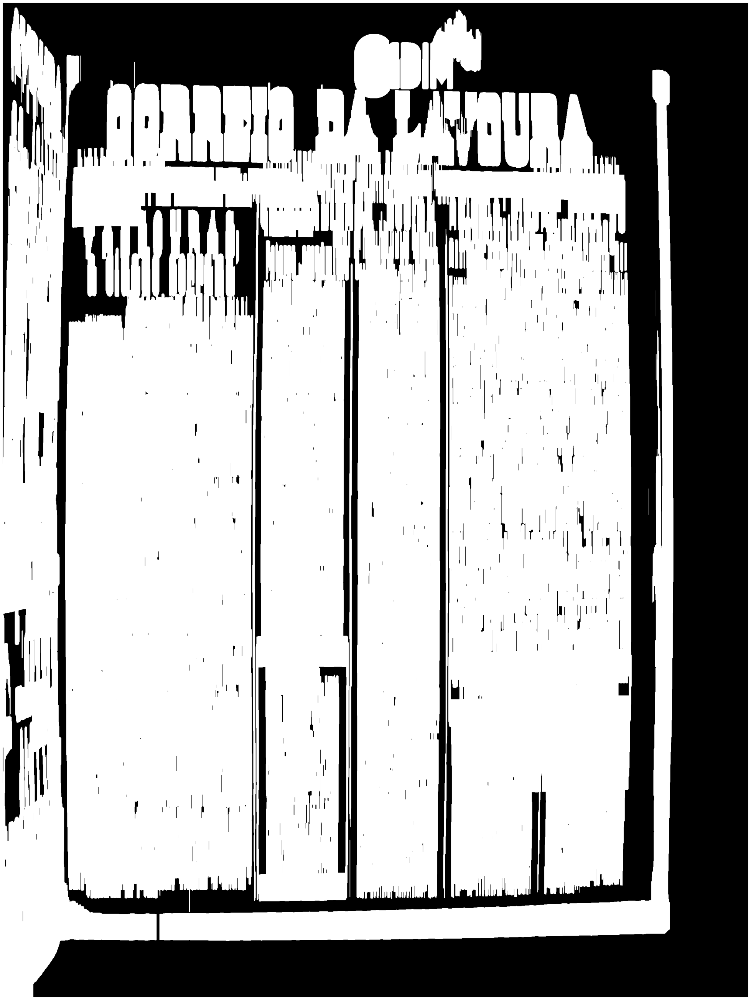

In [26]:
#img = cv2.imread(image_path)
blur = cv2.GaussianBlur(img_bw, (7, 7), 0)
thresh = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (1, 75))
dilate = cv2.dilate(thresh, kernel, iterations=1)

cv2.imwrite('temp/m_dilate.png', dilate)
display('temp/m_dilate.png')

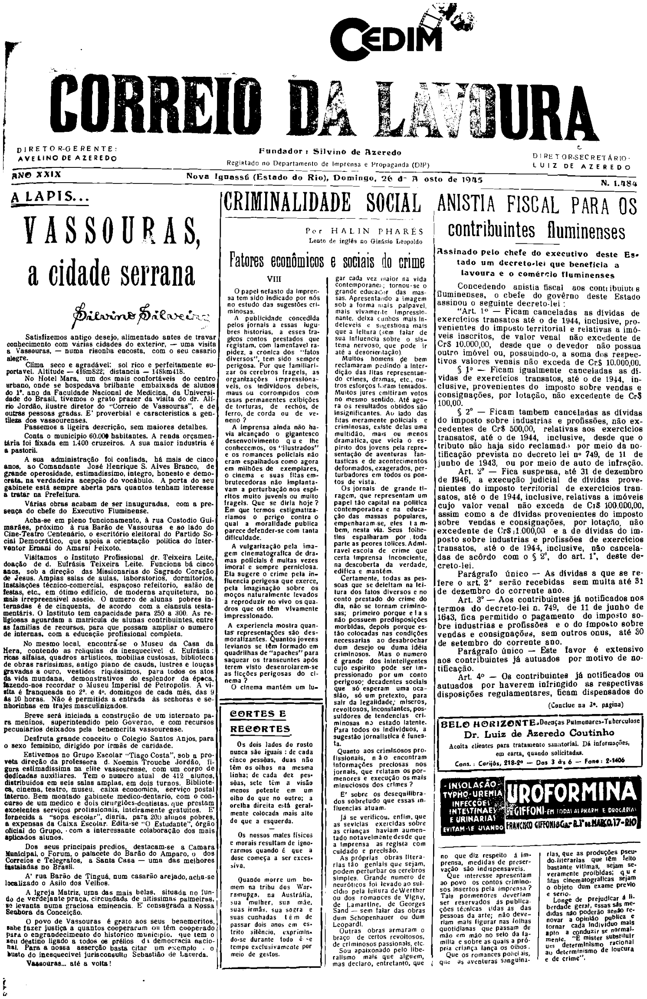

In [27]:
cnts = cv2.findContours(dilate, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
cnts = cnts[0] if len(cnts) == 2 else cnts[1]
cnts = sorted(cnts, key=lambda x: cv2.contourArea(x))
cnt = cnts[-1] # select largest
x, y, w, h = cv2.boundingRect(cnt)

img_main = img_bw[y:y+h, x:x+w]
cv2.imwrite(f'temp/main_body.png', img_main)
display('temp/main_body.png')

## Separando as colunas

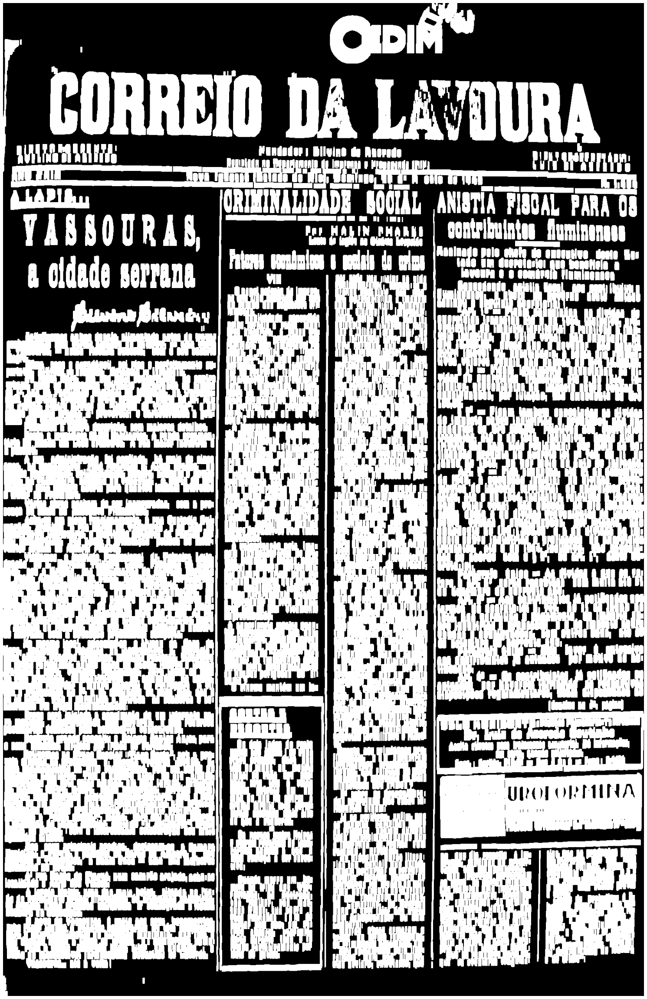

In [33]:
blur = cv2.GaussianBlur(img_main, (5, 5), 0)
thresh = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (3, 13))
dilate = cv2.dilate(thresh, kernel, iterations=1)
cv2.imwrite('temp/dilate.png', dilate)
display('temp/dilate.png')

In [36]:
def contains(columns, x, y, w, h):
    for c in columns:
        x1, y1, w1, h1 = c
        if x >= x1 and x + w <= x1 + w1 and y >= y1 and y + h <= y1 + h1:
            return True
    
    return False

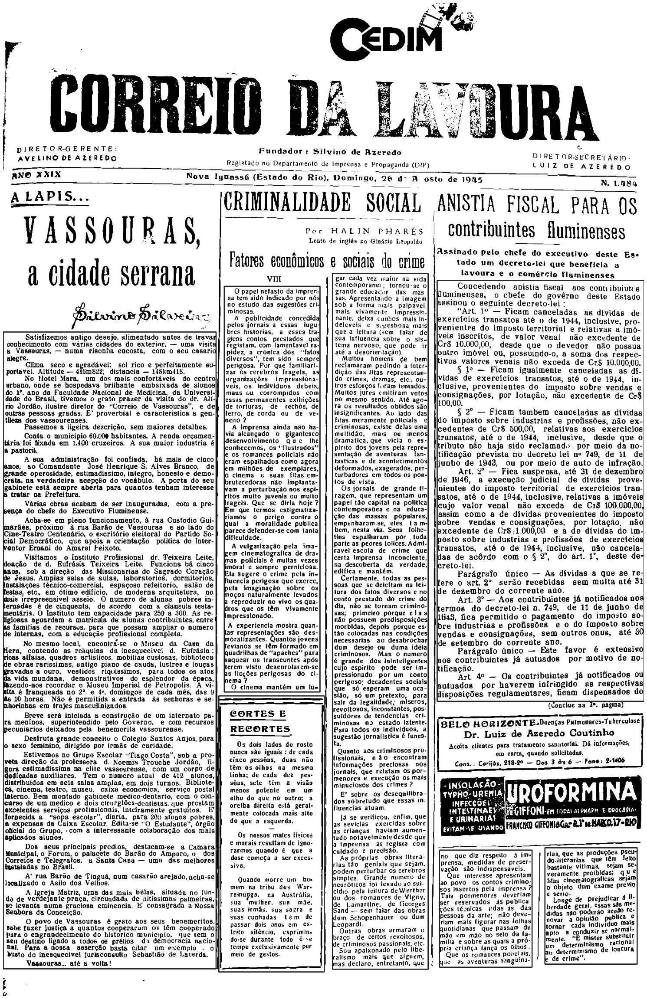

In [38]:
img = img_main.copy()
cnts = cv2.findContours(dilate, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
cnts = cnts[0] if len(cnts) == 2 else cnts[1]
cnts = sorted(cnts, key=lambda x: cv2.boundingRect(x)[0])
i = 0
columns = []
for c in cnts:
    x, y, w, h = cv2.boundingRect(c)
    if h > 200 and w > 150 and not contains(columns, x, y, w, h):
        columns.append((x, y, w, h))
        roi = img[y:y+h, x:x+w]
        cv2.imwrite(f'temp/columns/roi_{i}.png', roi)
        cv2.rectangle(img, (x, y), (x+w, y+h), (36, 255, 12), 2)
        i += 1
cv2.imwrite('temp/boxes.png', img)
display('temp/boxes.png')

## OCR das colunas

In [177]:
for i in range(len(columns)):
    roi = f'temp/columns/roi_{i}.png'
    out = f'output/columns/roi_{i}.txt'
    %time run_ocr(roi, out)

result = []
for i in range(len(columns)):
    roi = f'output/columns/roi_{i}.txt'
    with open(roi, encoding='utf-8') as f:
        result.append(f.read())
result = '\n\n'.join(result)
with open('output/columns.txt', 'w', encoding='utf-8') as f:
    f.write(result)

Wall time: 3.98 s
Wall time: 720 ms
Wall time: 1.62 s
Wall time: 3.2 s
Wall time: 3.17 s
Wall time: 940 ms
Wall time: 402 ms


## Separando o cabeçalho

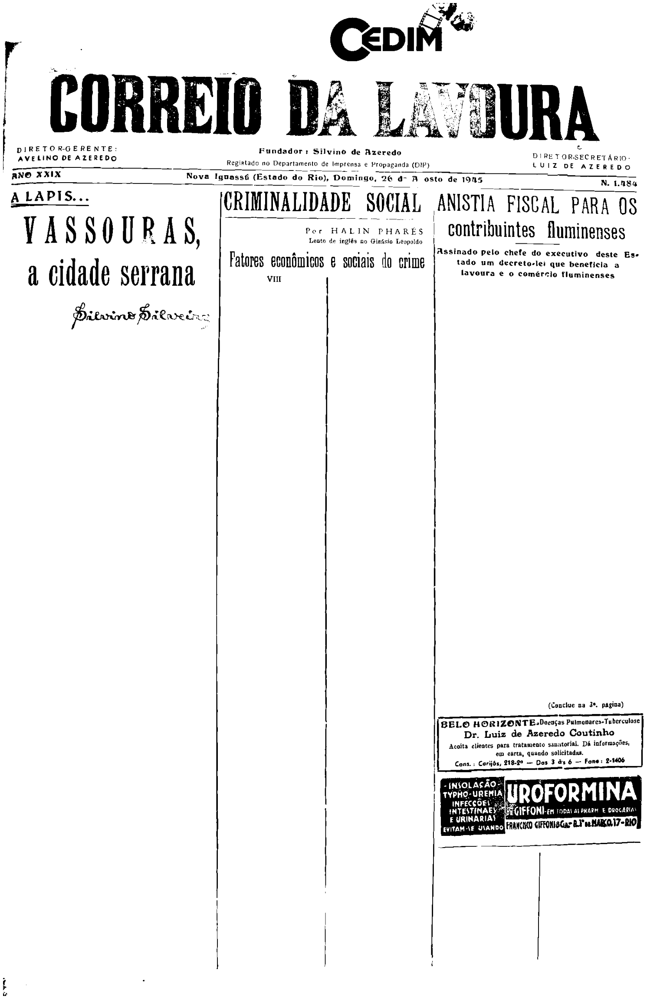

In [85]:
img_no_columns = img_main.copy()
for c in columns:
    x, y, w, h = c
    cv2.rectangle(img_no_columns, (x, y), (x+w, y+h), (255, 255, 255), -1)
cv2.imwrite('temp/no_columns.png', img_no_columns)
display('temp/no_columns.png')

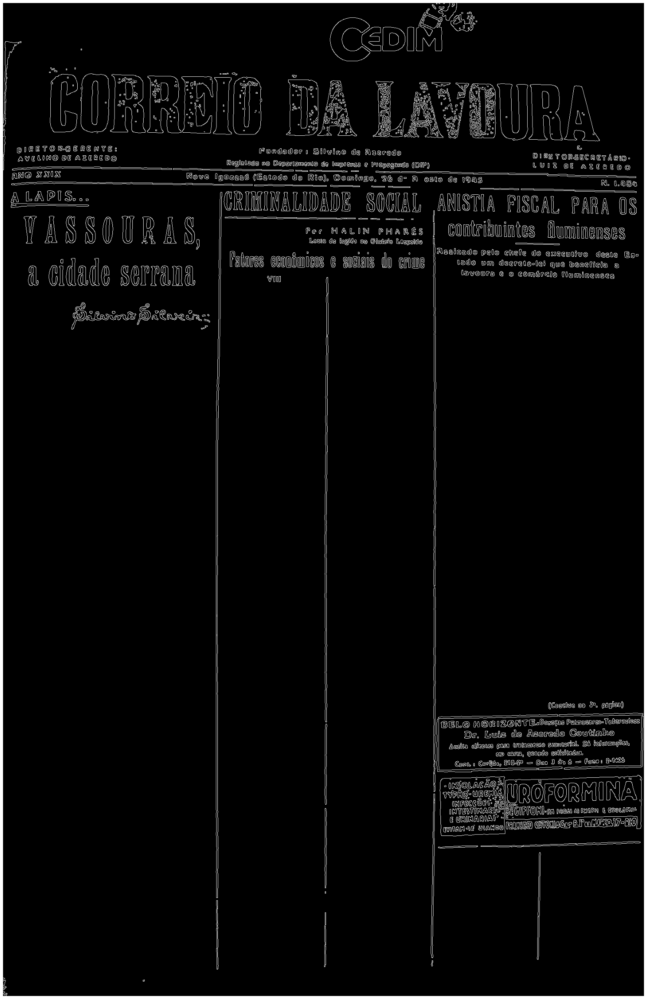

In [124]:
blur = cv2.GaussianBlur(img_no_columns, (5, 5), 0)
# thresh = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]
# kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (2, 3))
# dilate = cv2.dilate(thresh, kernel, iterations=1)

low_threshold = 50
high_threshold = 150
edges = cv2.Canny(blur, low_threshold, high_threshold)
cv2.imwrite('temp/lines.png', edges)
display('temp/lines.png')

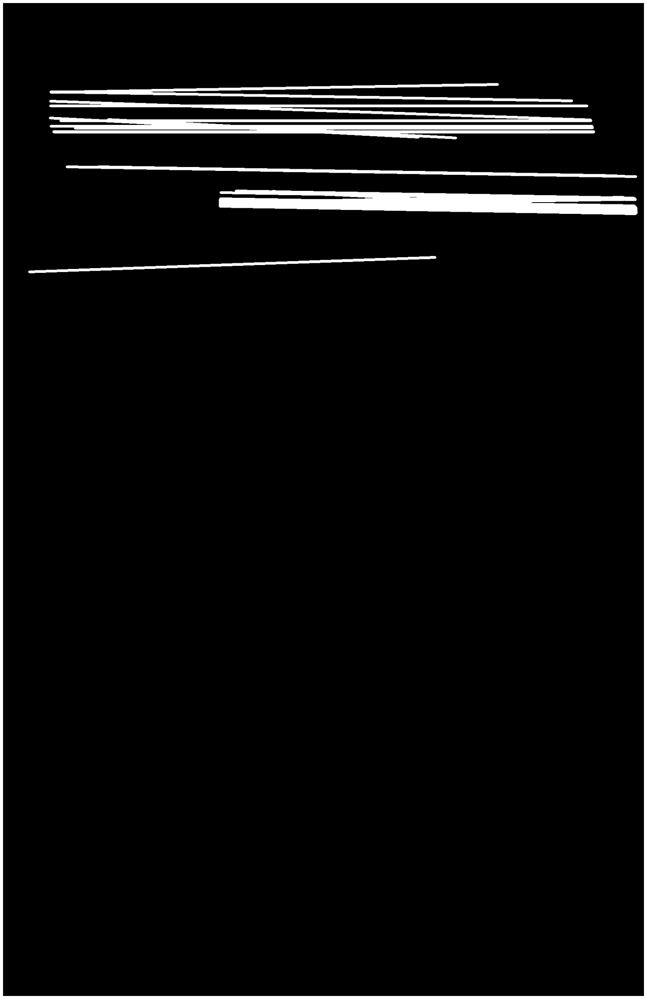

In [138]:
rho = 1  # distance resolution in pixels of the Hough grid
theta = np.pi / 180  # angular resolution in radians of the Hough grid
threshold = 7  # minimum number of votes (intersections in Hough grid cell)
min_line_length = 20  # minimum number of pixels making up a line
max_line_gap = 100  # maximum gap in pixels between connectable line segments
line_image = np.copy(img) * 0  # creating a blank to draw lines on

# Run Hough on edge detected image
# Output "lines" is an array containing endpoints of detected line segments
lines = cv2.HoughLinesP(edges, rho, theta, threshold, np.array([]),
                    min_line_length, max_line_gap)

long_lines = []
for line in lines:
    for x1,y1,x2,y2 in line:
        if abs(x2 - x1) > line_image.shape[1] * 0.5 and abs(y2 - y1) < 50:
            long_lines.append((x1, y1, x2, y2))
            cv2.line(line_image,(x1,y1),(x2,y2),(255,0,0),5)
cv2.imwrite('temp/lines.png', line_image)
display('temp/lines.png')

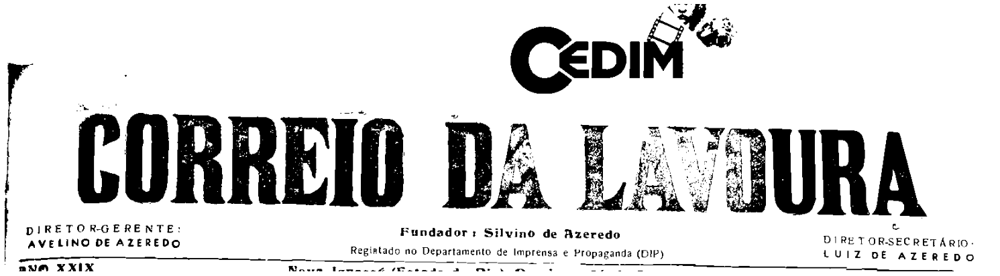

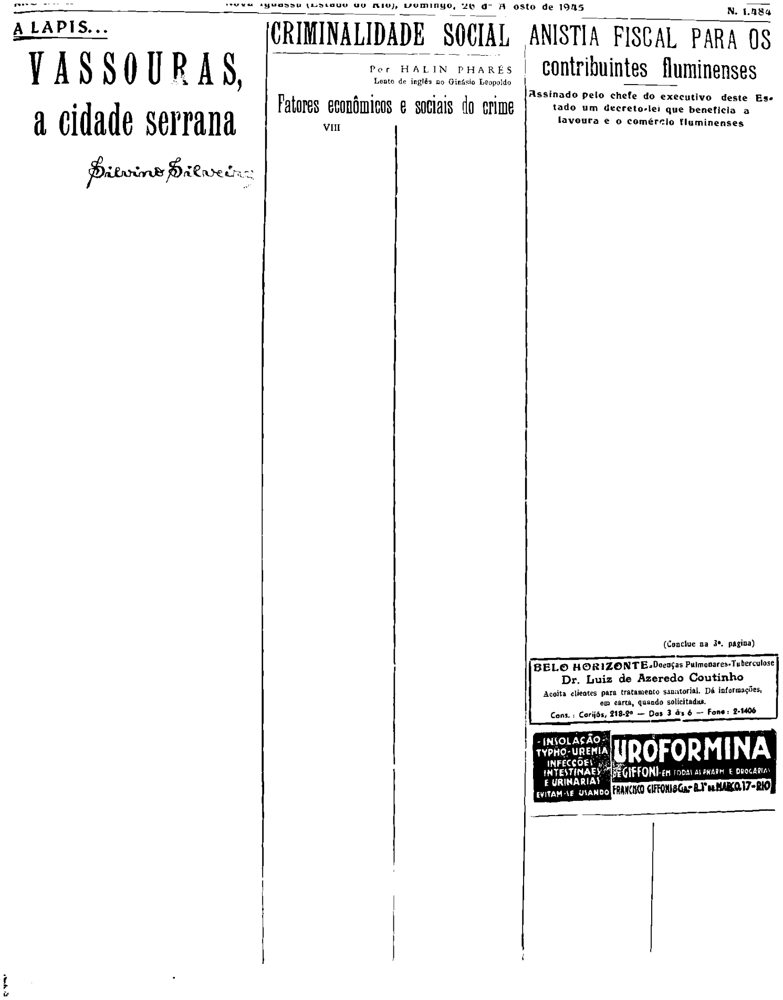

In [139]:
long_line = sorted(long_lines, key=lambda x: abs(x[0] - x[2]))[-1]
header_y = max(long_line[1], long_line[3])
img_header = img_no_columns[0:header_y,:]
cv2.imwrite('temp/header.png', img_header)
img_body = img_no_columns[header_y:,:]
cv2.imwrite('temp/body.png', img_body)
display('temp/header.png')
display('temp/body.png')

## Capturando os títulos

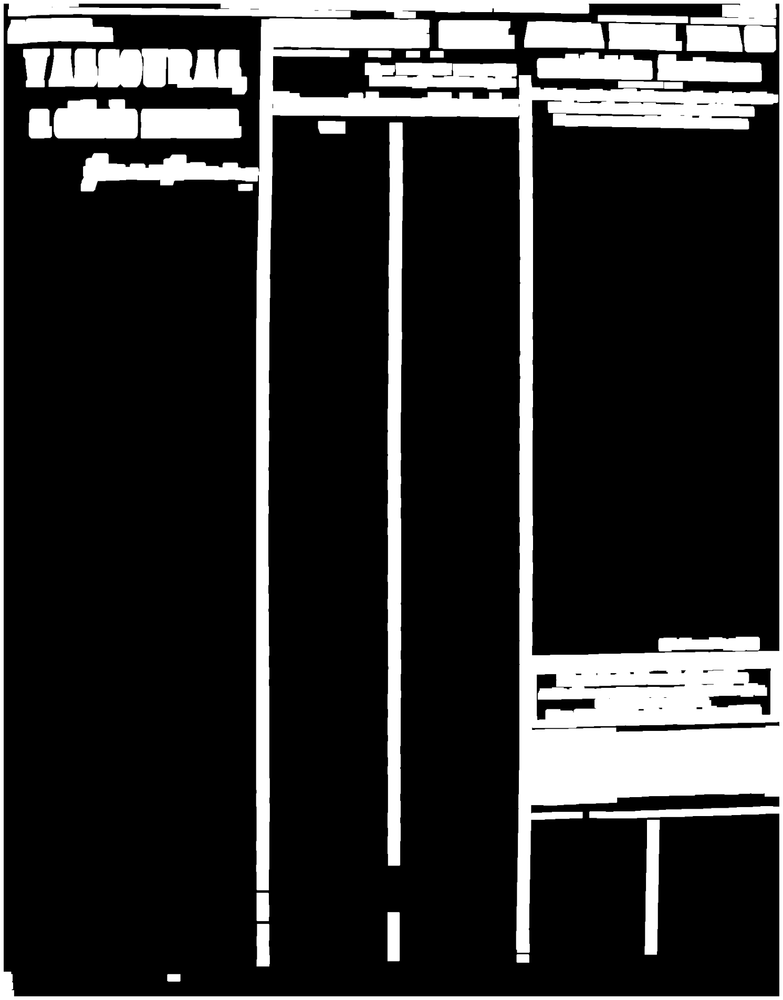

In [167]:
blur = cv2.GaussianBlur(img_body, (5, 5), 0)
thresh = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (25, 13))
dilate = cv2.dilate(thresh, kernel, iterations=1)
cv2.imwrite('temp/dilate.png', dilate)
display('temp/dilate.png')

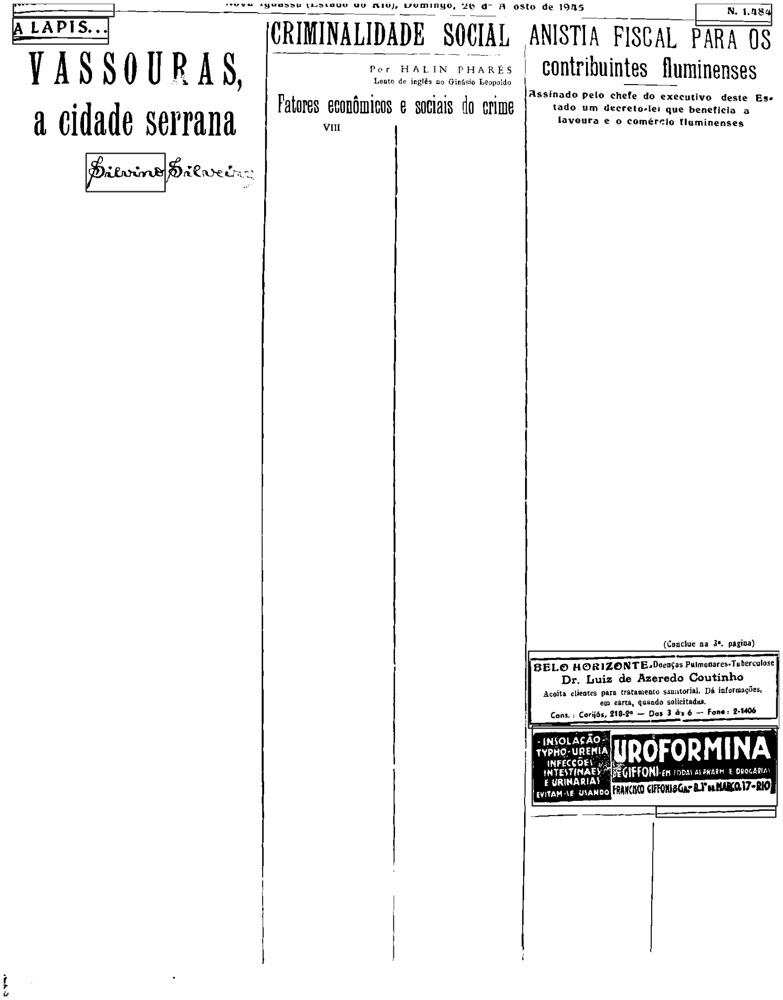

In [166]:
img = img_body.copy()
cnts = cv2.findContours(dilate, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
cnts = cnts[0] if len(cnts) == 2 else cnts[1]
cnts = sorted(cnts, key=lambda x: cv2.boundingRect(x)[0])
i = 0
for c in cnts:
    x, y, w, h = cv2.boundingRect(c)
    if h < 200 and w > 150:
        #roi = img[y:y+h, x:x+w]
        #cv2.imwrite(f'temp/columns/roi_{i}.png', roi)
        
        cv2.rectangle(img, (x, y), (x+w, y+h), (36, 255, 12), 2)
        i += 1
cv2.imwrite('temp/boxes.png', img)
display('temp/boxes.png')

In [159]:
def conflicts(columns, x, y, w, h):
    for c in columns:
        x1, y1, w1, h1 = c
        conflicts_x1 = x >= x1 and x <= x1 + w1
        conflicts_x2 = x + w >= x1 and x + w <= x1 + w1
        conflicts_y1 = y >= y1 and y <= y1 + h1
        conflicts_y2 = y + h >= y1 and y + h <= y1 + h1
        if conflicts_x1 and conflicts_y1 or conflicts_x2 and conflicts_y2:
            return True
    
    return False

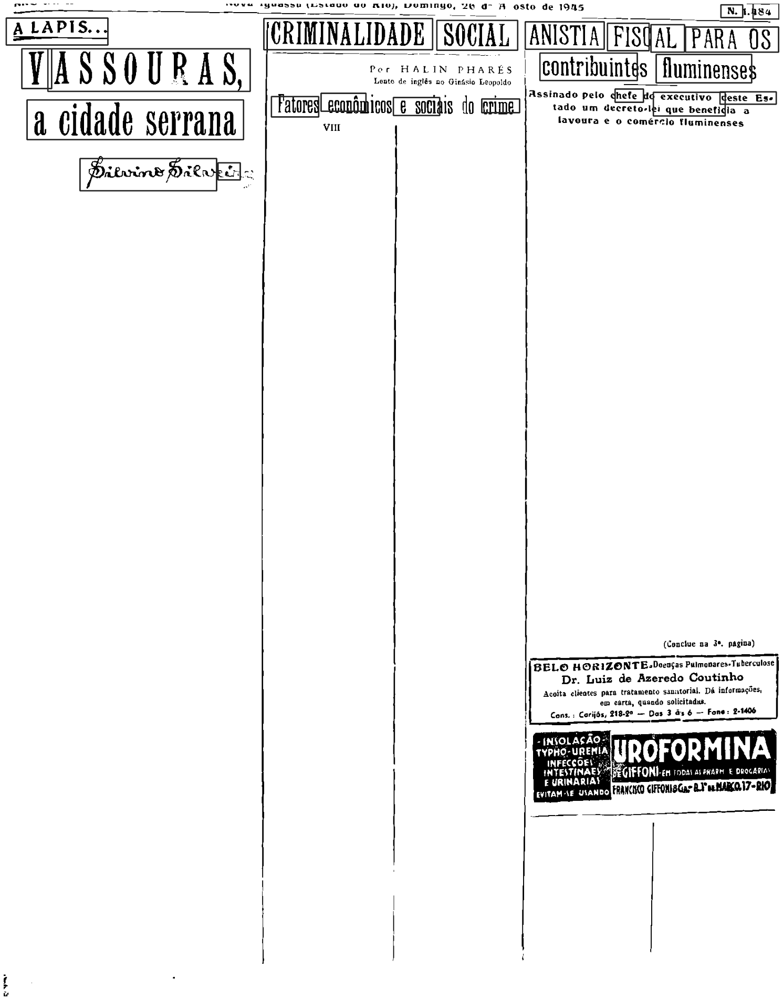

In [160]:
img = img_body.copy()
cnts = cv2.findContours(dilate, cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)
cnts = cnts[0] if len(cnts) == 2 else cnts[1]
cnts = sorted(cnts, key=lambda x: cv2.boundingRect(x)[0])
i = 0
for c in cnts:
    x, y, w, h = cv2.boundingRect(c)
    #if h > 50 and h < 400 and w > 50 and not conflicts(columns, x, y, w, h):
    if h > 25 and h < 400 and w > 40 and w < 500:
        #roi = img[y:y+h, x:x+w]
        #cv2.imwrite(f'temp/columns/roi_{i}.png', roi)
        cv2.rectangle(img, (x, y), (x+w, y+h), (36, 255, 12), 2)
    i += 1
cv2.imwrite('temp/boxes.png', img)
display('temp/boxes.png')